<a href="https://colab.research.google.com/github/Anantbir-S/AER850_Project3/blob/main/2_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

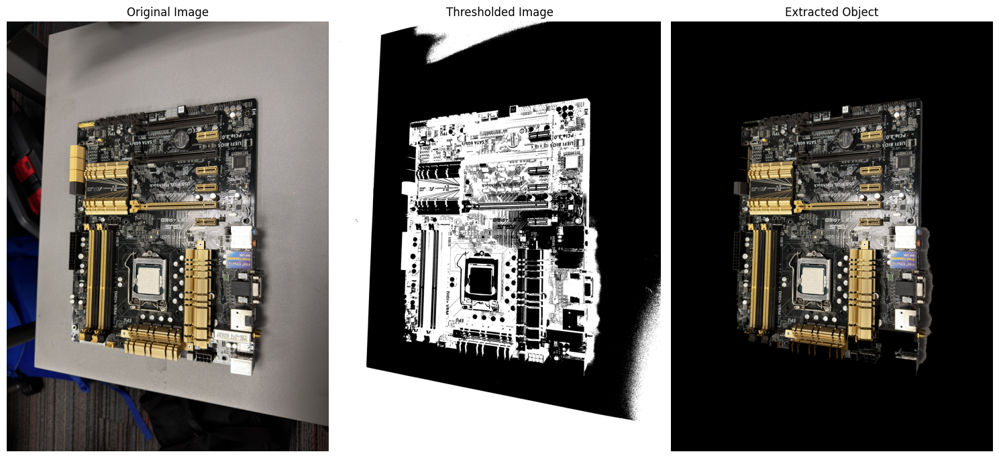

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image.JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Apply Thresholding
# Using a fixed threshold for simplicity. Adjust the value (e.g., 100) as needed.
_, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY_INV)

# Step 4: Find Contours
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Create a Mask
# Create an empty mask and draw the largest contour on it
mask = np.zeros_like(gray)
if contours:
    largest_contour = max(contours, key=cv2.contourArea)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

# Step 6: Extract the Object
extracted = cv2.bitwise_and(img, img, mask=mask)

# Display Results
plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.title("Original Image")
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title("Thresholded Image")
plt.imshow(thresh, cmap='gray')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title("Extracted Object")
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


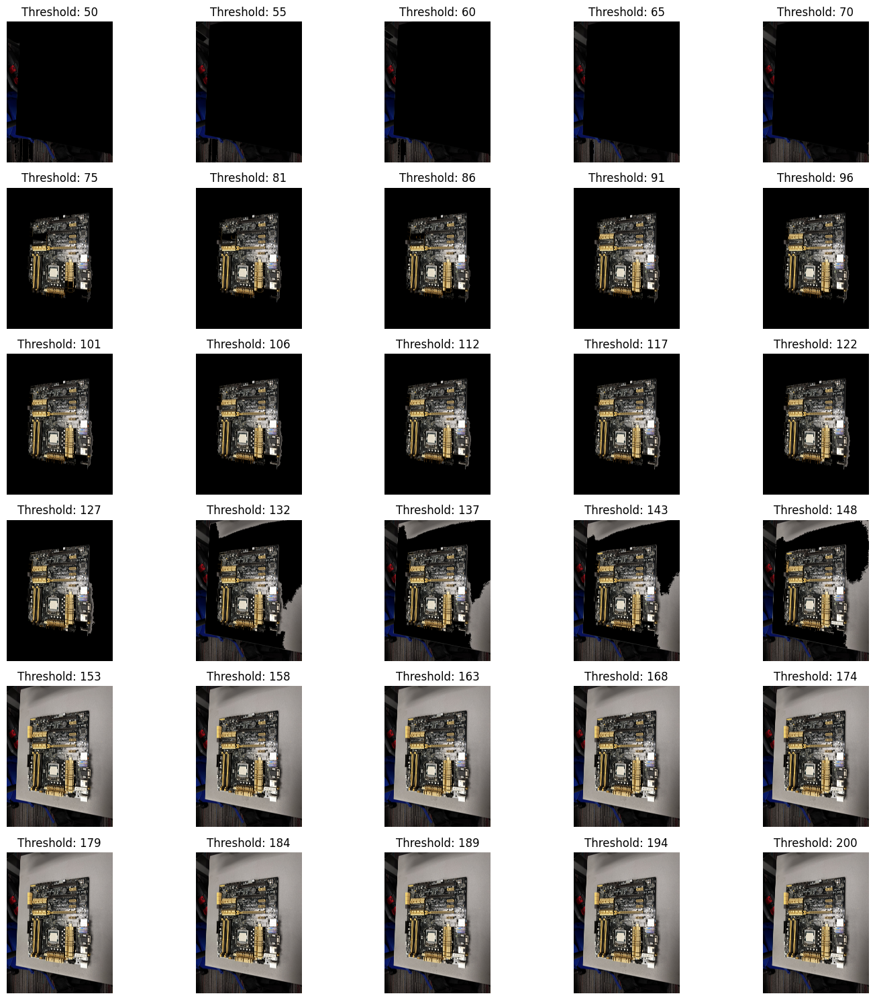

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image (1).JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define threshold values
threshold_values = np.linspace(50, 200, 30, dtype=int)  # 30 evenly spaced thresholds

# Initialize a figure for displaying results
plt.figure(figsize=(15, 15))
rows = 6  # Number of rows to display 30 results (5 images per row)

for i, thresh_val in enumerate(threshold_values):
    # Apply Thresholding
    _, thresh = cv2.threshold(gray, thresh_val, 255, cv2.THRESH_BINARY_INV)

    # Find Contours
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Create a Mask
    mask = np.zeros_like(gray)
    if contours:
        largest_contour = max(contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the Object
    extracted = cv2.bitwise_and(img, img, mask=mask)

    # Display the Final Extracted Image
    plt.subplot(rows, 5, i + 1)  # 5 images per row
    plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(f"Threshold: {thresh_val}")

# Show all results
plt.tight_layout()
plt.show()


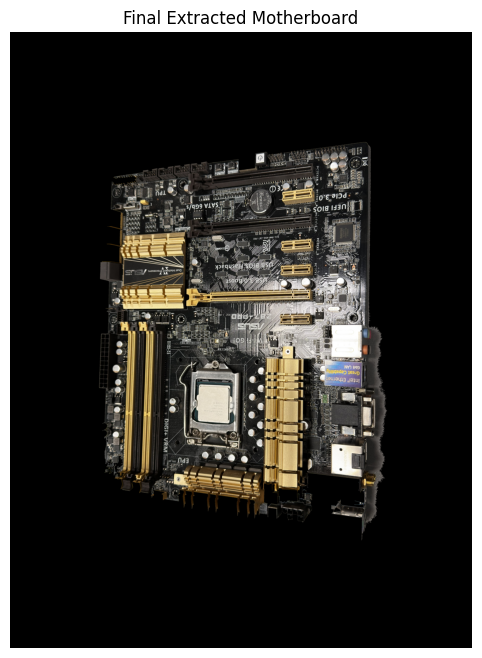

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image (1).JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Apply Thresholding
_, thresh = cv2.threshold(gray, 100, 255, cv2.THRESH_BINARY_INV)

# Step 4: Find Contours
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Create a Mask
mask = np.zeros_like(gray)
if contours:
    largest_contour = max(contours, key=cv2.contourArea)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

# Step 6: Extract the Object
extracted = cv2.bitwise_and(img, img, mask=mask)

# Step 7: Show the Final Extracted Image
plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title("Final Extracted Motherboard")
plt.show()


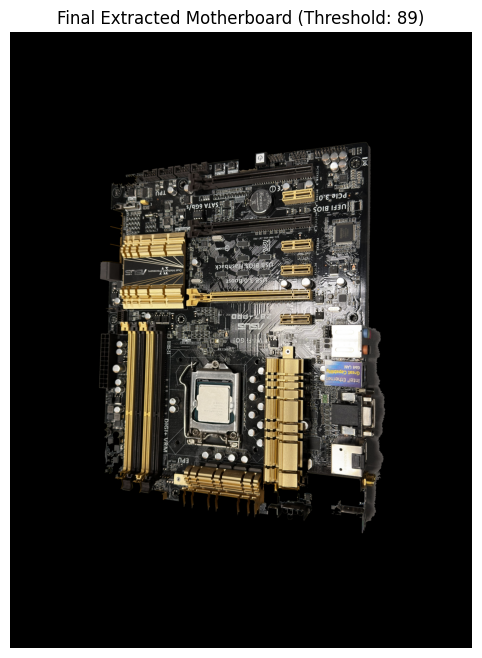

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image
image_path = '/content/motherboard_image (1).JPEG'  # Replace with your uploaded image path
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Apply the best threshold value
threshold_value = 89  # Best threshold determined
_, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

# Step 4: Find Contours
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Step 5: Create a Mask
mask = np.zeros_like(gray)
if contours:
    # Select the largest contour based on area
    largest_contour = max(contours, key=cv2.contourArea)
    cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

# Step 6: Refine the Mask with Morphological Operations
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))  # Elliptical kernel
mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)  # Close small gaps
mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)  # Remove small noise

# Step 7: Extract the Object
extracted = cv2.bitwise_and(img, img, mask=mask)

# Step 8: Show the Final Extracted Image
plt.figure(figsize=(8, 8))
plt.imshow(cv2.cvtColor(extracted, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.title("Final Extracted Motherboard (Threshold: 89)")
plt.show()


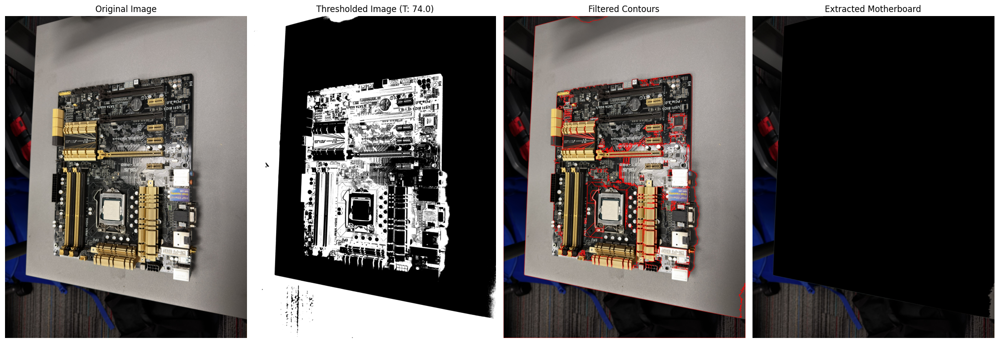

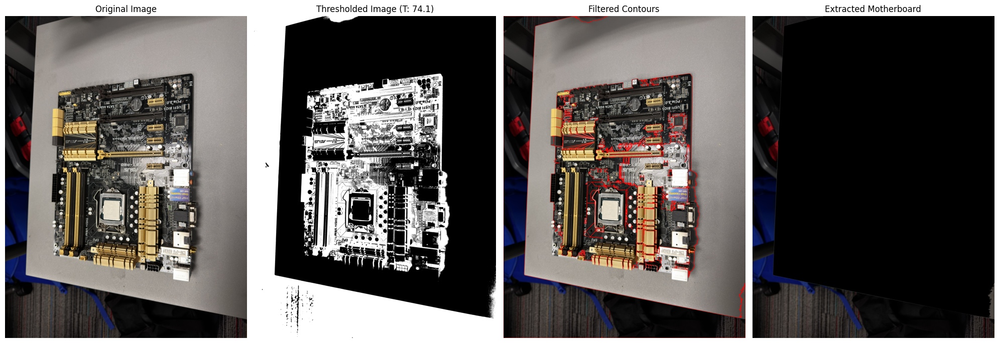

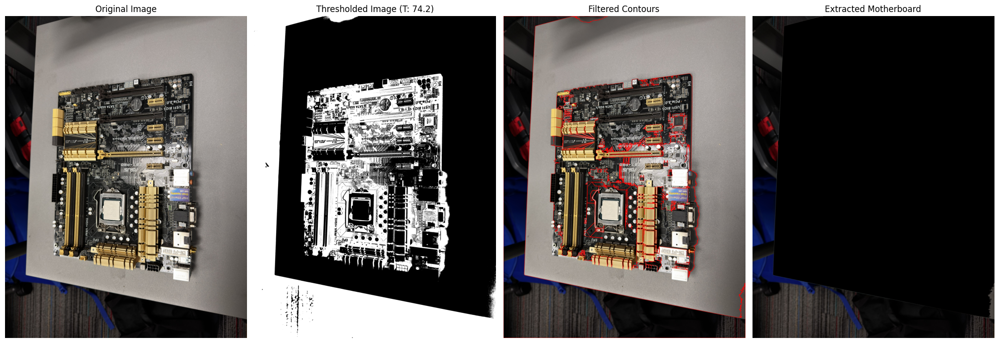

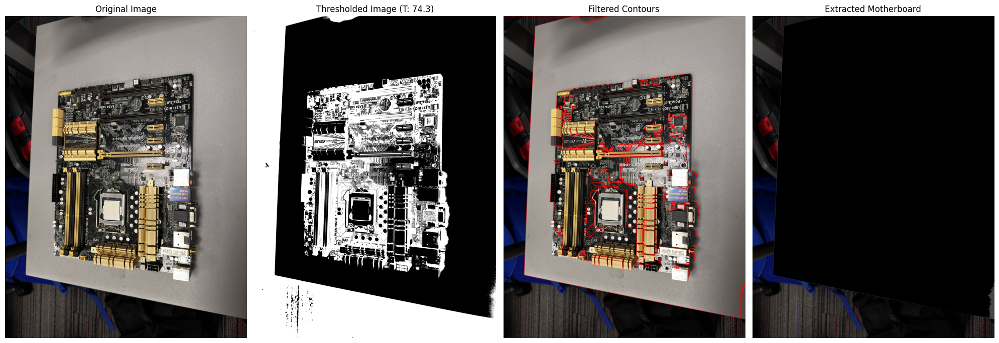

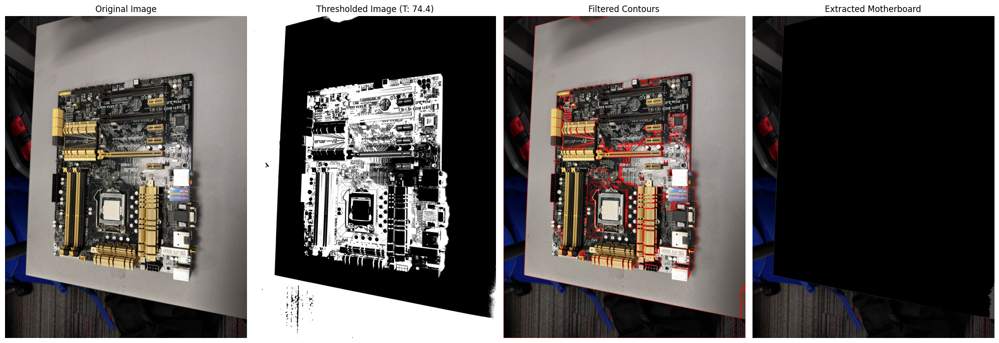

...

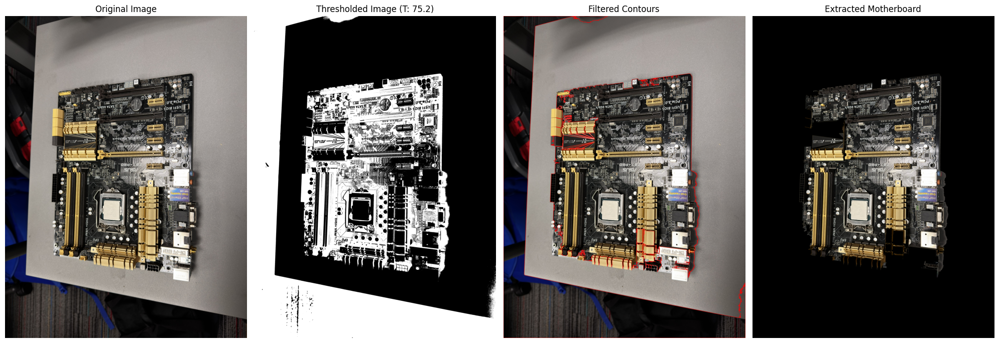

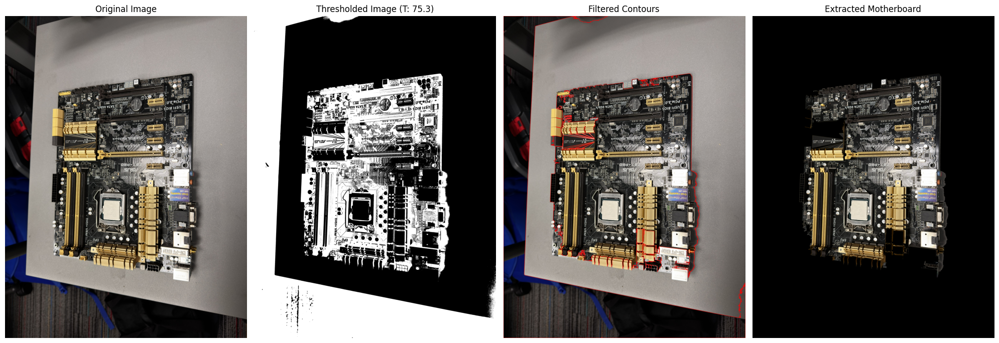

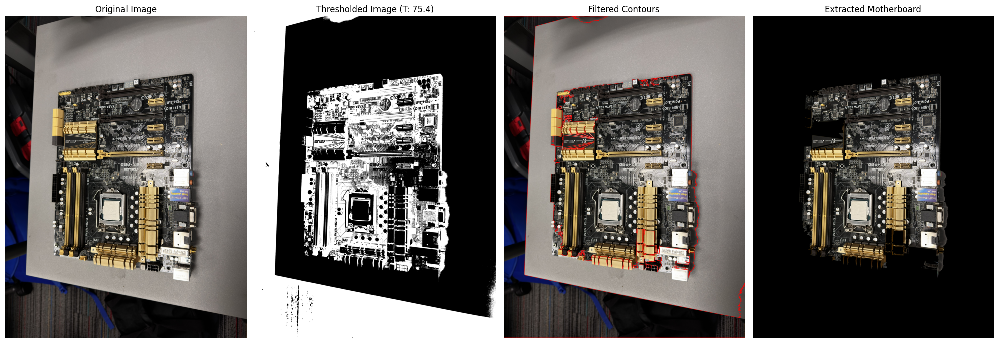

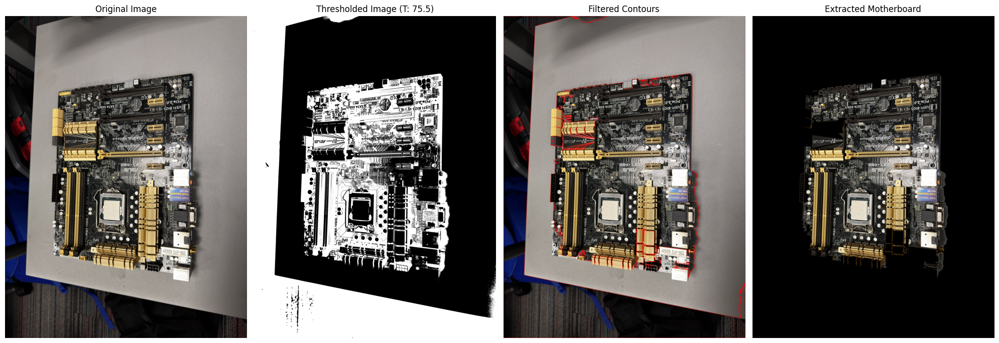

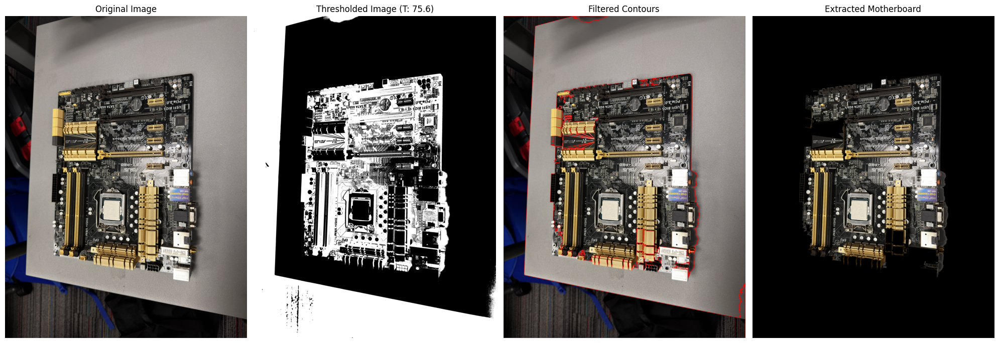

KeyboardInterrupt: 

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define a range of threshold values between 74 and 76
threshold_values = np.arange(74.0, 76.1, 0.1)  # Thresholds from 74.0 to 76.0 with step 0.1

# Loop through different threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Detect contours
    contours, hierarchy = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 5000  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Draw filtered contours with adjustable line thickness
    line_thickness = 3  # Set the desired line thickness
    contour_img = img_rgb.copy()
    cv2.drawContours(contour_img, filtered_contours, -1, (255, 0, 0), thickness=line_thickness)

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the motherboard using the mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Visualize the results for the current threshold
    plt.figure(figsize=(20, 10))

    plt.subplot(1, 4, 1)
    plt.title("Original Image")
    plt.imshow(img_rgb)
    plt.axis('off')

    plt.subplot(1, 4, 2)
    plt.title(f"Thresholded Image (T: {threshold_value:.1f})")
    plt.imshow(thresh, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 4, 3)
    plt.title("Filtered Contours")
    plt.imshow(contour_img)
    plt.axis('off')

    plt.subplot(1, 4, 4)
    plt.title("Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')

    plt.tight_layout()
    plt.show()


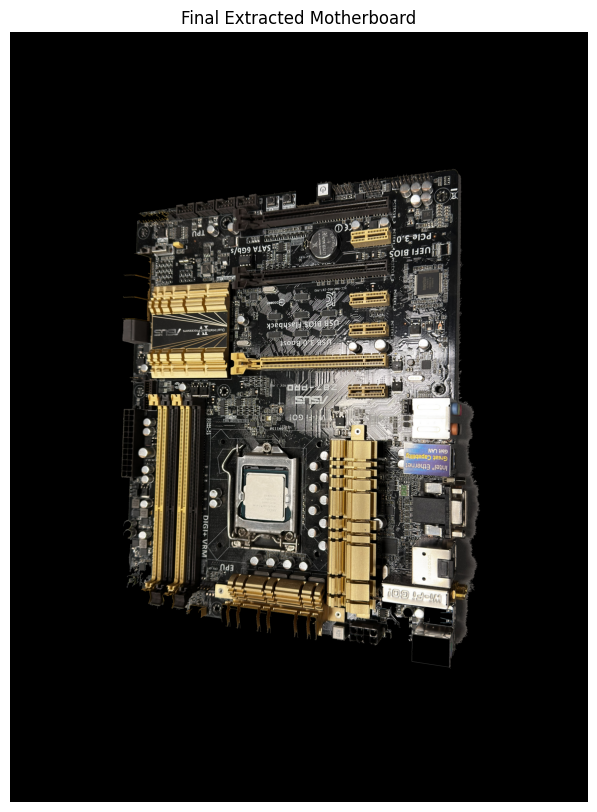

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

if img is None:
    raise ValueError("Image not loaded. Please check the file path.")

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define the specific threshold values
threshold_values = [88]  # Thresholds to process

# Loop through the specified threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Apply Canny edge detection
    edges = cv2.Canny(gray, 200, 100)  # Adjust thresholds for edge detection as needed

    # Combine threshold and edges
    combined_mask = cv2.bitwise_or(thresh, edges)

    # Detect contours from the combined mask
    contours, hierarchy = cv2.findContours(combined_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 500  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Extract the motherboard using the mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Display only the final extracted motherboard image
    plt.figure(figsize=(10, 10))
    plt.title("Final Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')
    plt.show()


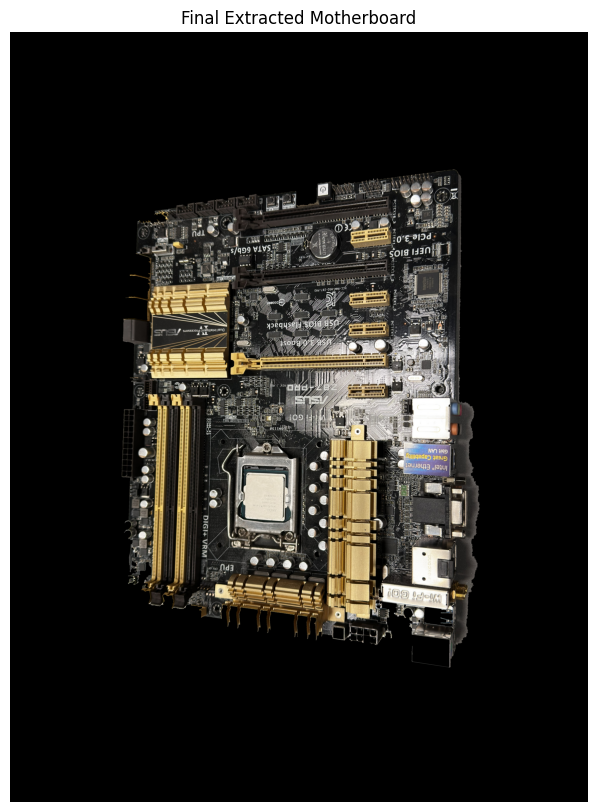

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Load the image from the provided path
image_path = '/content/motherboard_image.JPEG'
img = cv2.imread(image_path)

# Convert the image to RGB for visualization
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Step 2: Convert to grayscale
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Step 3: Define the specific threshold values
threshold_values = [88]  # Thresholds to process

# Loop through the specified threshold values
for threshold_value in threshold_values:
    # Apply thresholding
    _, thresh = cv2.threshold(gray, threshold_value, 255, cv2.THRESH_BINARY_INV)

    # Apply Canny edge detection
    edges = cv2.Canny(gray, 200, 200)  # Adjust thresholds for edge detection as needed

    # Combine threshold and edges
    combined_mask = cv2.bitwise_or(thresh, edges)

    # Detect contours from the combined mask
    contours, hierarchy = cv2.findContours(combined_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area
    min_area = 4000  # Minimum contour area to keep
    filtered_contours = [c for c in contours if cv2.contourArea(c) > min_area]

    # Create a mask from the largest filtered contour
    mask = np.zeros_like(gray)
    if filtered_contours:
        largest_contour = max(filtered_contours, key=cv2.contourArea)
        cv2.drawContours(mask, [largest_contour], -1, (255), thickness=cv2.FILLED)

    # Step 4: Apply morphological operations to refine the mask
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (10, 10))  # Kernel for morphological ops
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)  # Close gaps in the mask

    # Extract the motherboard using the refined mask
    extracted = cv2.bitwise_and(img_rgb, img_rgb, mask=mask)

    # Display only the final extracted motherboard image
    plt.figure(figsize=(10, 10))
    plt.title("Final Extracted Motherboard")
    plt.imshow(extracted)
    plt.axis('off')
    plt.show()
